In [3]:
!sudo apt-get update
!sudo apt-get install xvfb

Hit:1 https://cloud.r-project.org/bin/linux/ubuntu jammy-cran40/ InRelease
Hit:2 https://developer.download.nvidia.com/compute/cuda/repos/ubuntu2204/x86_64  InRelease
Get:3 http://security.ubuntu.com/ubuntu jammy-security InRelease [110 kB]
Hit:4 https://ppa.launchpadcontent.net/c2d4u.team/c2d4u4.0+/ubuntu jammy InRelease
Hit:5 https://ppa.launchpadcontent.net/deadsnakes/ppa/ubuntu jammy InRelease
Hit:6 https://ppa.launchpadcontent.net/graphics-drivers/ppa/ubuntu jammy InRelease
Hit:7 https://ppa.launchpadcontent.net/ubuntugis/ppa/ubuntu jammy InRelease
Hit:8 http://archive.ubuntu.com/ubuntu jammy InRelease
Get:9 http://archive.ubuntu.com/ubuntu jammy-updates InRelease [119 kB]
Hit:10 http://archive.ubuntu.com/ubuntu jammy-backports InRelease
Fetched 229 kB in 4s (52.0 kB/s)
Reading package lists... Done
Reading package lists... Done
Building dependency tree... Done
Reading state information... Done
xvfb is already the newest version (2:21.1.4-2ubuntu1.7~22.04.7).
0 upgraded, 0 newly i

### Установка зависимостей

На первом шаге мы начинаем с установки необходимых библиотек. Пакет [gymnasium](https://en.wikipedia.org/wiki/Q-learning#Deep_Q-learning) предоставляет различные среды для обучения с подкреплением, в то время как [stable-baselines3](https://en.wikipedia.org/wiki/Q-learning#Deep_Q-learning) предоставляет реализации различных алгоритмов обучения с подкреплением.


Эти пакеты будут использованы в дальнейшем коде для создания среды и реализации алгоритма обучения с подкреплением.

In [4]:
!apt-get install xvfb
!pip install gym[atari] autorom[accept-rom-license] gymnasium[mujoco] stable-baselines3 PyVirtualDisplay --quiet

Reading package lists... Done
Building dependency tree... Done
Reading state information... Done
xvfb is already the newest version (2:21.1.4-2ubuntu1.7~22.04.7).
0 upgraded, 0 newly installed, 0 to remove and 34 not upgraded.


In [5]:
!pip install -q swig
!pip install -q gymnasium[box2d]

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.8/1.8 MB 25.9 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 374.4/374.4 kB 1.9 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done


In [6]:
!pip install -q 'shimmy>=0.2.1'

После установки мы импортируем два основных модуля: gym и [DQN](https://en.wikipedia.org/wiki/Q-learning#Deep_Q-learning) из stable_baselines3. gym предоставляет инструменты для создания и использования различных сред для обучения агента, в то время как DQN (Deep Q-Network) представляет собой алгоритм Q-learning с использованием нейронных сетей для оценки функции Q.

In [7]:
# Импорт необходимых пакетов
import gymnasium as gym
from stable_baselines3 import DQN

In [8]:
gym.envs.registration.registry.keys()

dict_keys(['CartPole-v0', 'CartPole-v1', 'MountainCar-v0', 'MountainCarContinuous-v0', 'Pendulum-v1', 'Acrobot-v1', 'phys2d/CartPole-v0', 'phys2d/CartPole-v1', 'phys2d/Pendulum-v0', 'LunarLander-v2', 'LunarLanderContinuous-v2', 'BipedalWalker-v3', 'BipedalWalkerHardcore-v3', 'CarRacing-v2', 'Blackjack-v1', 'FrozenLake-v1', 'FrozenLake8x8-v1', 'CliffWalking-v0', 'Taxi-v3', 'tabular/Blackjack-v0', 'tabular/CliffWalking-v0', 'Reacher-v2', 'Reacher-v4', 'Pusher-v2', 'Pusher-v4', 'InvertedPendulum-v2', 'InvertedPendulum-v4', 'InvertedDoublePendulum-v2', 'InvertedDoublePendulum-v4', 'HalfCheetah-v2', 'HalfCheetah-v3', 'HalfCheetah-v4', 'Hopper-v2', 'Hopper-v3', 'Hopper-v4', 'Swimmer-v2', 'Swimmer-v3', 'Swimmer-v4', 'Walker2d-v2', 'Walker2d-v3', 'Walker2d-v4', 'Ant-v2', 'Ant-v3', 'Ant-v4', 'Humanoid-v2', 'Humanoid-v3', 'Humanoid-v4', 'HumanoidStandup-v2', 'HumanoidStandup-v4', 'GymV26Environment-v0', 'GymV21Environment-v0', 'Adventure-v0', 'AdventureDeterministic-v0', 'AdventureNoFrameskip-v0

### Выбор среды
Давайте определим задачу, которую мы будем решать, используя алгоритм Q-learning и библиотеки gym и stable-baselines3.


#### Создание среды LunarLander

Мы используем метод gym.make() для создания среды с именем 'LunarLander-v2'.

In [9]:
ENV_NAME = "LunarLander-v2"
TIMESTEPS = 400_000

In [10]:

env = gym.make(
    ENV_NAME,
    continuous = False,
    gravity = -11.0,
    enable_wind = True,
    turbulence_power = 1,
)

#### Описание задачи
Мы сохраняем информацию о пространстве наблюдений (observation_space) и пространстве действий (action_space). observation_space представляет собой пространство всех возможных состояний в задаче, а action_space - пространство всех возможных действий, которые агент может предпринять.

In [11]:
# Описание задачи
observation_space = env.observation_space
action_space = env.action_space

Эти шаги предварительно готовят нас к использованию выбранной среды для обучения и тестирования агента с использованием алгоритма Q-learning.

### Решение задачи
На этом шаге мы используем алгоритм Q-learning, представленный в stable-baselines3, для решения задачи CartPole. Давайте разберем каждый этап.


#### Инициализация модели DQN
Мы создаем экземпляр модели Deep Q-Network (DQN) с использованием DQN("MlpPolicy", env, verbose=1). Здесь "MlpPolicy" означает полносвязную нейронную сеть в качестве политики. env - это среда CartPole, а verbose=1 добавляет вывод для отслеживания прогресса обучения.

In [12]:
# Инициализация модели DQN
model = DQN("MlpPolicy", env, verbose=1)

Using cuda device
Wrapping the env with a `Monitor` wrapper
Wrapping the env in a DummyVecEnv.


#### Обучение модели
Мы вызываем метод learn() для обучения модели на 500000 временных шагах (total_timesteps=500000).

In [13]:
# Обучение модели
model.learn(total_timesteps=TIMESTEPS, log_interval=1000)
model.save("dqn_" + ENV_NAME.lower())

----------------------------------
| rollout/            |          |
|    ep_len_mean      | 504      |
|    ep_rew_mean      | -114     |
|    exploration_rate | 0.05     |
| time/               |          |
|    episodes         | 1000     |
|    fps              | 870      |
|    time_elapsed     | 341      |
|    total_timesteps  | 297135   |
| train/              |          |
|    learning_rate    | 0.0001   |
|    loss             | 3.36     |
|    n_updates        | 61783    |
----------------------------------


#### Тестирование модели
Мы тестируем обученную модель, используя цикл, в котором агент принимает решения в соответствии с обученной политикой на каждом временном шаге. Мы используем метод render(), чтобы визуализировать среду в реальном времени.

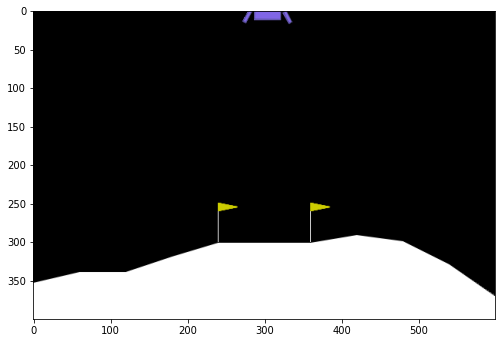

In [14]:
import gym
from tqdm import tqdm
from IPython import display
from pyvirtualdisplay import Display
import matplotlib.pyplot as plt
from matplotlib import animation


d = Display()
d.start()

env = gym.make(ENV_NAME)

obs = env.reset()

img = []
for _ in tqdm(range(1000)):
    action, _states = model.predict(obs, deterministic=True)
    obs, reward, terminated, truncated = env.step(action)

    display.clear_output(wait=True)
    img.append(env.render('rgb_array'))

dpi = 72
interval = 50 # ms

plt.figure(figsize=(img[0].shape[1]/dpi,img[0].shape[0]/dpi),dpi=dpi)
patch = plt.imshow(img[0])
plt.axis=('off')
animate = lambda i: patch.set_data(img[i])
ani = animation.FuncAnimation(plt.gcf(),animate,frames=len(img),interval=interval)
display.display(display.HTML(ani.to_jshtml()))

In [16]:
import matplotlib
matplotlib.rcParams['animation.embed_limit'] = 2**128

#### Закрытие среды после тестирования
По завершении тестирования мы закрываем среду с помощью env.close().

In [17]:
# Закрытие среды после тестирования
env.close()